In [1]:
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt  
xlsx_file = "Empower.csv"
init_data = pd.read_csv(xlsx_file)
init_data

,SETTLEMENTDATE,REGIONID,TOTALDEMAND
0,2017-01-01 00:30:00.000,NSW1,7259.07000
1,2017-01-01 00:30:00.000,QLD1,6462.14000
2,2017-01-01 00:30:00.000,SA1,1395.21000
3,2017-01-01 00:30:00.000,TAS1,863.08000
4,2017-01-01 00:30:00.000,VIC1,4097.58000
...,...,...,...
481675,2022-07-01 00:00:00.000,NSW1,8731.47500
481676,2022-07-01 00:00:00.000,QLD1,5624.54500
481677,2022-07-01 00:00:00.000,SA1,1694.35000
481678,2022-07-01 00:00:00.000,TAS1,1134.75833


In [2]:
xlsx_file = "ElecMMS3_ROOFTOP_PV_ACTUAL_pivot.csv"
PV_pivot_data = pd.read_csv(xlsx_file)
# PV_pivot_data = PV_pivot_data.fillna(0)
print(str(PV_pivot_data['POWER_DAILY']))
print(type(init_data['SETTLEMENTDATE']))

init_data['added_PV_TOTALDEMAND'] = init_data['TOTALDEMAND']
for i in range(len(init_data)):
    if not pd.isna(PV_pivot_data['POWER_DAILY'][i]): 
        init_data['added_PV_TOTALDEMAND'][i] = PV_pivot_data['POWER_DAILY'][i] + init_data['TOTALDEMAND'][i]
    else:
        if pd.isna(PV_pivot_data['POWER_DAILY'][i]) and not pd.isna(PV_pivot_data['POWER_MEASUREMENT'][i]):
            init_data['added_PV_TOTALDEMAND'][i] = PV_pivot_data['POWER_MEASUREMENT'][i] + init_data['TOTALDEMAND'][i]
PV_pivot_data

0         0.0
1         0.0
2         0.0
3         0.0
4         0.0
         ... 
481675    NaN
481676    NaN
481677    NaN
481678    NaN
481679    NaN
Name: POWER_DAILY, Length: 481680, dtype: float64
<class 'pandas.core.series.Series'>


C:\Users\bcjsp\anaconda3\envs\CV\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.
C:\Users\bcjsp\anaconda3\envs\CV\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  del sys.path[0]


,INTERVAL_DATETIME,REGIONID,POWER_DAILY,QI_DAILY,POWER_MEASUREMENT,QI_MEASUREMENT,POWER_SATELLITE,QI_SATELLITE
0,2017-01-01 00:30:00,NSW1,0.0,1.0,NaN,NaN,NaN,NaN
1,2017-01-01 00:30:00,QLD1,0.0,1.0,NaN,NaN,NaN,NaN
2,2017-01-01 00:30:00,SA1,0.0,1.0,NaN,NaN,NaN,NaN
3,2017-01-01 00:30:00,TAS1,0.0,1.0,NaN,NaN,NaN,NaN
4,2017-01-01 00:30:00,VIC1,0.0,1.0,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...
481675,2022-07-01 00:00:00,NSW1,NaN,NaN,0.0,1.0,0.0,0.6
481676,2022-07-01 00:00:00,QLD1,NaN,NaN,0.0,1.0,0.0,0.6
481677,2022-07-01 00:00:00,SA1,NaN,NaN,0.0,1.0,0.0,0.6
481678,2022-07-01 00:00:00,TAS1,NaN,NaN,0.0,1.0,0.0,0.6


In [3]:
xlsx_file = "MarketData_dbo_Public_Holidays.csv"
Public_Holidays_data = pd.read_csv(xlsx_file)
Public_Holidays_data

,ID,Date,Holiday,NEM,AFMA_NSW,AFMA_VIC,AFMA_SA,AFMA_QLD,AFMA_TAS,ASX_NSW,...,ASX_SA,ASX_QLD,Official_NSW,Official_VIC,Official_QLD,Official_TAS,Official_SA,Official_ACT,Official_WA,Official_NT
0,1,2002-01-01,New Year's Day,True,True,True,True,True,True,False,...,False,False,True,True,True,True,True,True,True,True
1,2,2002-01-28,Australia Day,True,True,True,True,True,True,False,...,False,False,True,True,True,True,True,True,True,True
2,3,2002-02-11,Royal Hobart Regatta,False,False,False,False,False,True,False,...,False,False,False,False,False,True,False,False,False,False
3,4,2002-03-11,Eight Hours Day,False,False,False,False,False,True,False,...,False,False,False,False,False,True,False,False,False,False
4,5,2002-03-11,Labour Day,False,False,True,False,False,False,False,...,False,False,False,True,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
560,541,2033-08-10,Royal Queensland Show Day,NaN,False,False,NaN,True,False,NaN,...,NaN,NaN,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN
561,542,2033-10-03,Labour Day,NaN,True,False,NaN,True,False,NaN,...,NaN,NaN,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN
562,543,2033-11-01,Melbourne Cup Day,NaN,False,True,NaN,False,True,NaN,...,NaN,NaN,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN
563,544,2033-12-26,Boxing Day,NaN,True,True,NaN,True,True,NaN,...,NaN,NaN,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN


In [5]:
Public_Holidays_data['Timedate'] = pd.to_datetime(Public_Holidays_data['Date'], format="%Y-%m-%d")
Public_Holidays_data

,ID,Date,Holiday,NEM,AFMA_NSW,AFMA_VIC,AFMA_SA,AFMA_QLD,AFMA_TAS,ASX_NSW,...,ASX_QLD,Official_NSW,Official_VIC,Official_QLD,Official_TAS,Official_SA,Official_ACT,Official_WA,Official_NT,Timedate
0,1,2002-01-01,New Year's Day,True,True,True,True,True,True,False,...,False,True,True,True,True,True,True,True,True,2002-01-01
1,2,2002-01-28,Australia Day,True,True,True,True,True,True,False,...,False,True,True,True,True,True,True,True,True,2002-01-28
2,3,2002-02-11,Royal Hobart Regatta,False,False,False,False,False,True,False,...,False,False,False,False,True,False,False,False,False,2002-02-11
3,4,2002-03-11,Eight Hours Day,False,False,False,False,False,True,False,...,False,False,False,False,True,False,False,False,False,2002-03-11
4,5,2002-03-11,Labour Day,False,False,True,False,False,False,False,...,False,False,True,False,False,False,False,False,False,2002-03-11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
560,541,2033-08-10,Royal Queensland Show Day,NaN,False,False,NaN,True,False,NaN,...,NaN,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN,2033-08-10
561,542,2033-10-03,Labour Day,NaN,True,False,NaN,True,False,NaN,...,NaN,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN,2033-10-03
562,543,2033-11-01,Melbourne Cup Day,NaN,False,True,NaN,False,True,NaN,...,NaN,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN,2033-11-01
563,544,2033-12-26,Boxing Day,NaN,True,True,NaN,True,True,NaN,...,NaN,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN,2033-12-26


In [127]:
NSW_data = init_data[init_data.REGIONID == 'NSW1'].reset_index()
QLD_data = init_data[init_data.REGIONID == 'QLD1'].reset_index()
SA_data = init_data[init_data.REGIONID == 'SA1'].reset_index()
TAS_data = init_data[init_data.REGIONID == 'TAS1'].reset_index()
VIC_data = init_data[init_data.REGIONID == 'VIC1'].reset_index()
df = NSW_data
NSW_data

,index,SETTLEMENTDATE,REGIONID,TOTALDEMAND,added_PV_TOTALDEMAND
0,0,2017-01-01 00:30:00.000,NSW1,7259.07000,7259.07000
1,5,2017-01-01 01:00:00.000,NSW1,7046.41000,7046.41000
2,10,2017-01-01 01:30:00.000,NSW1,6845.24000,6845.24000
3,15,2017-01-01 02:00:00.000,NSW1,6629.92000,6629.92000
4,20,2017-01-01 02:30:00.000,NSW1,6472.71000,6472.71000
...,...,...,...,...,...
96331,481655,2022-06-30 22:00:00.000,NSW1,9629.76833,9629.76833
96332,481660,2022-06-30 22:30:00.000,NSW1,9513.61833,9513.61833
96333,481665,2022-06-30 23:00:00.000,NSW1,9192.70167,9192.70167
96334,481670,2022-06-30 23:30:00.000,NSW1,8971.18667,8971.18667


In [128]:

def timeseries_train_test_split(X, y, test_size):
    """
        Perform train-test split with respect to time series structure
    """
    
    # get the index after which test set starts
    test_index = int(len(X)*(1-test_size))
    
    X_train = X.iloc[:test_index]
    y_train = y.iloc[:test_index]
    X_test = X.iloc[test_index:]
    y_test = y.iloc[test_index:]
    
    return X_train, X_test, y_train, y_test

def mean_absolute_percentage_error(y_true, y_pred): 
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# NSW Data

In [129]:
NSW_data['date'] = pd.to_datetime(df['SETTLEMENTDATE'], format="%Y-%m-%d %H:%M:%S.%f")

In [130]:
%%time

Public_Holidays_data['date'] = pd.to_datetime(Public_Holidays_data['Date'], format="%Y-%m-%d %H:%M:%S.%f")
Public_Holidays_data
df['is_public_holiday'] = 0
for j in range(len(df)):
    for i in range(len(Public_Holidays_data)):
        if Public_Holidays_data['Official_NSW'][i] == True or Public_Holidays_data['AFMA_NSW'][i] == True or Public_Holidays_data['ASX_NSW'][i] == True:
            if Public_Holidays_data['Timedate'][i] == NSW_data['date'][j].date():
                df['is_public_holiday'][j] = 1

C:\Users\bcjsp\anaconda3\envs\CV\lib\site-packages\ipykernel_launcher.py:7: FutureWarning: Comparison of Timestamp with datetime.date is deprecated in order to match the standard library behavior.  In a future version these will be considered non-comparable.Use 'ts == pd.Timestamp(date)' or 'ts.date() == date' instead.
  import sys
C:\Users\bcjsp\anaconda3\envs\CV\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


Wall time: 19min 54s


In [9]:
df.to_csv('NSW_df.csv')

In [131]:
data = pd.DataFrame(NSW_data.added_PV_TOTALDEMAND.copy())
data.columns = ["y"]

In [132]:
# data.index = data.index.to_datetime()
data["hour"] = df.date.dt.hour
data["weekday"] = df.date.dt.weekday
data["month"] = df.date.dt.month
data["year"] = df.date.dt.year
data['is_weekend'] = data.weekday.isin([5,6])*1
data["is_public_holiday"] = df.is_public_holiday
data

,y,hour,weekday,month,year,is_weekend,is_public_holiday
0,7259.07000,0,6,1,2017,1,0
1,7046.41000,1,6,1,2017,1,0
2,6845.24000,1,6,1,2017,1,0
3,6629.92000,2,6,1,2017,1,0
4,6472.71000,2,6,1,2017,1,0
...,...,...,...,...,...,...,...
96331,9629.76833,22,3,6,2022,0,0
96332,9513.61833,22,3,6,2022,0,0
96333,9192.70167,23,3,6,2022,0,0
96334,8971.18667,23,3,6,2022,0,0


In [135]:
xlsx_file = "-33.86882_151.209295_Solcast_PT30M.csv"   #NSW
weather_data = pd.read_csv(xlsx_file)
weather_data['PeriodStart'][0]
weather_data['date'] = pd.to_datetime(weather_data['PeriodEnd'], format="%Y-%m-%dT%H:%M:%SZ")
weather_data
from datetime import timedelta
weather_data['date'] = weather_data['date'] + timedelta(hours=10)
weather_data
new_weather = weather_data.loc[weather_data['date']>='2017-01-01 01:00:00']
new_weather = new_weather.loc[new_weather['date']<='2022-07-01 00:00:00']
new_weather
new = pd.concat([new_weather,df],axis=0)
new_merge = df.merge(new_weather,on=['date'])
# # new_merge = new_merge.rename(columns={'TOTALDEMAND':'y'})
new_merge = new_merge.reset_index()
df_col = pd.concat([new_merge,data], axis=1)
train_data = df_col.drop(columns=['level_0','index','SETTLEMENTDATE','REGIONID','TOTALDEMAND','added_PV_TOTALDEMAND','date','PeriodEnd','PeriodStart','Period'])
train_data

,is_public_holiday,AirTemp,Azimuth,CloudOpacity,DewpointTemp,Dhi,Dni,Ebh,Ghi,PrecipitableWater,...,WindSpeed10m,Zenith,AlbedoDaily,y,hour,weekday,month,year,is_weekend,is_public_holiday
0,0.0,20.2,-167.0,0.0,19.2,0.0,0.0,0.0,0.0,38.0,...,2.6,122.0,0.09,7259.07000,0,6,1,2017,1,0
1,0.0,20.0,-159.0,0.0,19.1,0.0,0.0,0.0,0.0,38.1,...,2.5,120.0,0.09,7046.41000,1,6,1,2017,1,0
2,0.0,20.0,-152.0,0.0,19.1,0.0,0.0,0.0,0.0,38.1,...,2.3,118.0,0.09,6845.24000,1,6,1,2017,1,0
3,0.0,20.0,-145.0,0.0,19.1,0.0,0.0,0.0,0.0,38.2,...,2.2,114.0,0.09,6629.92000,2,6,1,2017,1,0
4,0.0,20.0,-139.0,0.0,19.1,0.0,0.0,0.0,0.0,38.3,...,2.0,110.0,0.09,6472.71000,2,6,1,2017,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96331,0.0,14.6,109.0,72.2,9.1,0.0,0.0,0.0,0.0,22.0,...,3.4,155.0,0.11,9629.76833,22,3,6,2022,0,0
96332,0.0,14.4,119.0,68.6,9.3,0.0,0.0,0.0,0.0,22.1,...,3.2,161.0,0.11,9513.61833,22,3,6,2022,0,0
96333,0.0,14.2,136.0,60.0,9.5,0.0,0.0,0.0,0.0,22.2,...,3.0,166.0,0.11,9192.70167,23,3,6,2022,0,0
96334,0.0,13.9,165.0,57.0,9.7,0.0,0.0,0.0,0.0,22.4,...,2.9,169.0,0.11,8971.18667,23,3,6,2022,0,0


In [136]:


data = train_data
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

y = data.dropna().y
X = data.dropna().drop(['y'], axis=1)

X_train, X_test, y_train, y_test = timeseries_train_test_split(X, y, test_size=0.3)

X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

3.179761771843275
RMSE: 364.169833


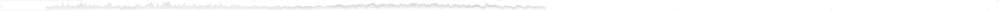

[0.01615942 0.01193955 0.01193852 ... 0.02410556 0.01711071 0.0082915 ]
Predictions(scale=array([8077.6997, 7562.2383, 7549.6997, ..., 8879.853 , 8754.8   ,
       8608.562 ], dtype=float32), s=array([0.01615942, 0.01193955, 0.01193852, ..., 0.02410556, 0.01711071,
       0.0082915 ], dtype=float32))


In [137]:
# lognorm
from sklearn.model_selection import cross_val_score
from sklearn.metrics import r2_score, median_absolute_error, mean_absolute_error
from sklearn.metrics import median_absolute_error, mean_squared_error, mean_squared_log_error
from xgboost import XGBRegressor 
from xgboost_distribution import XGBDistribution

def plotModelResults(model, X_train=X_train, X_test=X_test, plot_intervals=False, plot_anomalies=False, scale=19.6):
    """
        Plots modelled vs fact values, prediction intervals and anomalies
    
    """
    
    prediction = model.predict(X_test)
    
    plt.figure(figsize=(600, 7))
    plt.plot(prediction, "g", label="prediction", linewidth=2.0)
#     plt.plot(y_test.values, label="actual", linewidth=2.0)

    print(y_test)
    print(prediction)
    plt.show()

xgb = XGBDistribution(distribution="log-normal")
xgb.fit(X_train_scaled, y_train)
testpred = xgb.predict(X_test_scaled)

mean, std = testpred.scale, testpred.s


plt.figure(figsize=(600, 7))
plt.plot(mean, "g", label="prediction", linewidth=2.0)
plt.plot(y_test.values, label="actual", linewidth=2.0)
plt.plot(mean+np.exp(std), "r--",label="upper", alpha=0.5,linewidth=2.0)
plt.plot(mean-np.exp(std),"r--", label="lower", alpha=0.5,linewidth=2.0)
error = mean_absolute_percentage_error(mean, y_test)
# print(y_test)
# print(prediction)
print(error)
plt.title("Mean absolute percentage error {0:.2f}%".format(error))
rmse = np.sqrt(mean_squared_error(mean, y_test))
print("RMSE: %f" % (rmse))
plt.legend(loc="best")
plt.tight_layout()
plt.grid(True);
plt.show()

print(std)


print(testpred)
# plotModelResults(xgb, 
#                  X_train=X_train_scaled, 
#                  X_test=X_test_scaled, 
#                  plot_intervals=False,plot_anomalies=False)


C:\Users\bcjsp\anaconda3\envs\CV\lib\site-packages\ipykernel_launcher.py:12: UserWarning: FixedFormatter should only be used together with FixedLocator
  if sys.path[0] == "":


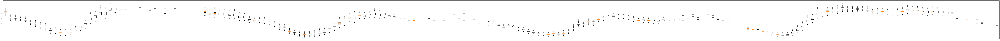

In [138]:
from scipy.stats import lognorm

fig = plt.figure(figsize =(180, 7))
ax = fig.add_axes([1, 1, 1, 1])
data = []
for i in range(200): #change to any numbers
    np.random.seed(1)

#generate log-normal distributed random variable with 1000 values
    lognorm_values = lognorm.rvs(s=testpred.s[i], scale=testpred.scale[i], size=1000)
    data.append(lognorm_values)
ax.set_xticklabels(X_test.hour[0:200])    
ax.boxplot(x=data)
# plt.plot(y_test_reset[0:200])
# ax.plot(y_test_reset[0:200],linewidth = 2.0)
# ax.plot(y_test[0:200])

plt.show()    

<BarContainer object of 23 artists>

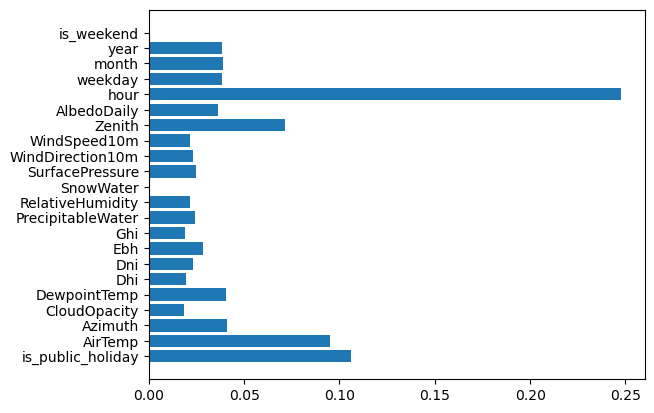

In [139]:
plt.barh(X_train.columns, xgb.feature_importances_)

# VIC Data 

In [36]:
df_VIC=VIC_data
VIC_data['date'] = pd.to_datetime(df_VIC['SETTLEMENTDATE'], format="%Y-%m-%d %H:%M:%S.%f")
Public_Holidays_data['date'] = pd.to_datetime(Public_Holidays_data['Date'], format="%Y-%m-%d %H:%M:%S.%f")
Public_Holidays_data

df_VIC['is_public_holiday'] = 0
for j in range(len(df_VIC)):
    for i in range(len(Public_Holidays_data)):
        if Public_Holidays_data['Official_VIC'][i] == True or Public_Holidays_data['AFMA_VIC'][i] == True or Public_Holidays_data['ASX_VIC'][i] == True:
            if Public_Holidays_data['Timedate'][i] == VIC_data['date'][j].date():
                print(VIC_data['date'][j].date())
                df_VIC['is_public_holiday'][j] = 1

C:\Users\bcjsp\anaconda3\envs\CV\lib\site-packages\ipykernel_launcher.py:10: FutureWarning: Comparison of Timestamp with datetime.date is deprecated in order to match the standard library behavior.  In a future version these will be considered non-comparable.Use 'ts == pd.Timestamp(date)' or 'ts.date() == date' instead.
  # Remove the CWD from sys.path while we load stuff.


2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02


C:\Users\bcjsp\anaconda3\envs\CV\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if sys.path[0] == "":


2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-03-13
2017-03-13
2017-03-13
2017-03-13
2017-03-13
2017-03-13
2017-03-13
2017-03-13
2017-03-13
2017-03-13
2017-03-13
2017-03-13

2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11

2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01

2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-05
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25

In [37]:
df_VIC.to_csv('VIC_df.csv')

In [45]:
data = pd.DataFrame(VIC_data.added_PV_TOTALDEMAND.copy())
data.columns = ["y"]
data["hour"] = df_VIC.date.dt.hour
data["month"] = df_VIC.date.dt.month
data["year"] = df_VIC.date.dt.year
data["weekday"] = df_VIC.date.dt.weekday
data['is_weekend'] = data.weekday.isin([5,6])*1
data["is_public_holiday"] = df_VIC.is_public_holiday
data

,y,hour,month,year,weekday,is_weekend,is_public_holiday
0,4097.58000,0,1,2017,6,1,0
1,4034.74000,1,1,2017,6,1,0
2,3851.70000,1,1,2017,6,1,0
3,3649.99000,2,1,2017,6,1,0
4,3517.65000,2,1,2017,6,1,0
...,...,...,...,...,...,...,...
96331,6251.47333,22,6,2022,3,0,0
96332,5930.04667,22,6,2022,3,0,0
96333,5685.67833,23,6,2022,3,0,0
96334,5698.64333,23,6,2022,3,0,0


In [46]:
xlsx_file = "-37.813628_144.963058_Solcast_PT30M.csv"   #VIC
weather_data = pd.read_csv(xlsx_file)
weather_data['PeriodStart'][0]
weather_data['date'] = pd.to_datetime(weather_data['PeriodEnd'], format="%Y-%m-%dT%H:%M:%SZ")
weather_data
from datetime import timedelta
weather_data['date'] = weather_data['date'] + timedelta(hours=10)
weather_data
new_weather = weather_data.loc[weather_data['date']>='2017-01-01 01:00:00']
new_weather = new_weather.loc[new_weather['date']<='2022-07-01 00:00:00']

new_weather
print(len(new_weather))
new = pd.concat([new_weather,df],axis=0)
new_merge = df.merge(new_weather,on=['date']) 
# new_merge = new_merge.rename(columns={'TOTALDEMAND':'y'}) 
new_merge = new_merge.reset_index() 
df_col = pd.concat([new_merge,data], axis=1)
df_col
train_data = df_col.drop(columns=['level_0','index','SETTLEMENTDATE','REGIONID','TOTALDEMAND','added_PV_TOTALDEMAND','date','PeriodEnd','PeriodStart','Period'])
train_data

96335


,is_public_holiday,AirTemp,Azimuth,CloudOpacity,DewpointTemp,Dhi,Dni,Ebh,Ghi,PrecipitableWater,...,WindSpeed10m,Zenith,AlbedoDaily,y,hour,month,year,weekday,is_weekend,is_public_holiday
0,0.0,15.3,-174.0,0.0,13.6,0.0,0.0,0.0,0.0,18.6,...,2.5,119.0,0.13,4097.58000,0,1,2017,6,1,0
1,0.0,15.2,-166.0,0.0,13.6,0.0,0.0,0.0,0.0,18.7,...,2.5,118.0,0.13,4034.74000,1,1,2017,6,1,0
2,0.0,15.1,-159.0,0.0,13.6,0.0,0.0,0.0,0.0,18.8,...,2.5,116.0,0.13,3851.70000,1,1,2017,6,1,0
3,0.0,15.0,-152.0,0.0,13.6,0.0,0.0,0.0,0.0,18.9,...,2.5,114.0,0.13,3649.99000,2,1,2017,6,1,0
4,0.0,14.9,-145.0,0.0,13.6,0.0,0.0,0.0,0.0,18.9,...,2.5,110.0,0.13,3517.65000,2,1,2017,6,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96331,0.0,7.9,109.0,40.5,4.8,0.0,0.0,0.0,0.0,12.0,...,0.3,149.0,0.15,6251.47333,22,6,2022,3,0,0
96332,0.0,7.9,118.0,62.9,5.0,0.0,0.0,0.0,0.0,12.9,...,0.6,155.0,0.15,5930.04667,22,6,2022,3,0,0
96333,0.0,8.0,130.0,73.9,5.3,0.0,0.0,0.0,0.0,13.5,...,0.7,159.0,0.15,5685.67833,23,6,2022,3,0,0
96334,0.0,8.2,149.0,68.7,5.6,0.0,0.0,0.0,0.0,13.9,...,0.6,163.0,0.15,5698.64333,23,6,2022,3,0,0


In [47]:
data = train_data
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

y = data.dropna().y
X = data.dropna().drop(['y'], axis=1)

X_train, X_test, y_train, y_test = timeseries_train_test_split(X, y, test_size=0.3)

X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

4.1510236933252935
RMSE: 291.930320


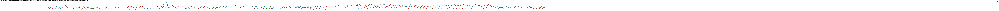

[0.02089389 0.01635969 0.01793661 ... 0.01294666 0.01357465 0.01248518]
Predictions(scale=array([4602.64  , 4470.559 , 4367.5312, ..., 5870.243 , 5603.664 ,
       5695.0854], dtype=float32), s=array([0.02089389, 0.01635969, 0.01793661, ..., 0.01294666, 0.01357465,
       0.01248518], dtype=float32))


In [48]:
# lognorm
from sklearn.model_selection import cross_val_score
from sklearn.metrics import r2_score, median_absolute_error, mean_absolute_error
from sklearn.metrics import median_absolute_error, mean_squared_error, mean_squared_log_error
from xgboost import XGBRegressor 
from xgboost_distribution import XGBDistribution

def plotModelResults(model, X_train=X_train, X_test=X_test, plot_intervals=False, plot_anomalies=False, scale=19.6):
    """
        Plots modelled vs fact values, prediction intervals and anomalies
    
    """
    
    prediction = model.predict(X_test)
    
    plt.figure(figsize=(600, 7))
    plt.plot(prediction, "g", label="prediction", linewidth=2.0)
#     plt.plot(y_test.values, label="actual", linewidth=2.0)

    print(y_test)
    print(prediction)
    plt.show()

xgb = XGBDistribution(distribution="log-normal")
xgb.fit(X_train_scaled, y_train)
testpred = xgb.predict(X_test_scaled)

mean, std = testpred.scale, testpred.s


plt.figure(figsize=(600, 7))
plt.plot(mean, "g", label="prediction", linewidth=2.0)
plt.plot(y_test.values, label="actual", linewidth=2.0)
plt.plot(mean+np.exp(std), "r--",label="upper", alpha=0.5,linewidth=2.0)
plt.plot(mean-np.exp(std),"r--", label="lower", alpha=0.5,linewidth=2.0)
error = mean_absolute_percentage_error(mean, y_test)
# print(y_test)
# print(prediction)
print(error)
plt.title("Mean absolute percentage error {0:.2f}%".format(error))
rmse = np.sqrt(mean_squared_error(mean, y_test))
print("RMSE: %f" % (rmse))
plt.legend(loc="best")
plt.tight_layout()
plt.grid(True);
plt.show()

print(std)


print(testpred)

C:\Users\bcjsp\anaconda3\envs\CV\lib\site-packages\ipykernel_launcher.py:10: UserWarning: FixedFormatter should only be used together with FixedLocator
  # Remove the CWD from sys.path while we load stuff.


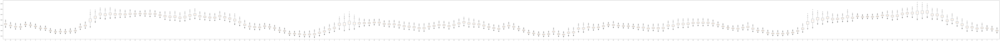

In [49]:
fig = plt.figure(figsize =(180, 7))
ax = fig.add_axes([1, 1, 1, 1])
data = []
for i in range(200): #change to any numbers
    np.random.seed(1)

#generate log-normal distributed random variable with 1000 values
    lognorm_values = lognorm.rvs(s=testpred.s[i], scale=testpred.scale[i], size=1000)
    data.append(lognorm_values)
ax.set_xticklabels(X_test.hour[0:200])    
ax.boxplot(x=data)
# plt.plot(y_test_reset[0:200])
# ax.plot(y_test_reset[0:200],linewidth = 2.0)
# ax.plot(y_test[0:200])

plt.show()    

<BarContainer object of 23 artists>

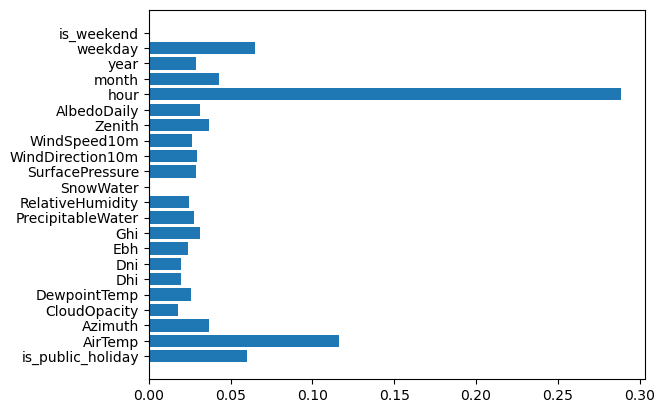

In [50]:
plt.barh(X_train.columns, xgb.feature_importances_)

# SA Data

In [51]:
df_SA=SA_data
SA_data['date'] = pd.to_datetime(df_SA['SETTLEMENTDATE'], format="%Y-%m-%d %H:%M:%S.%f")
Public_Holidays_data['date'] = pd.to_datetime(Public_Holidays_data['Date'], format="%Y-%m-%d %H:%M:%S.%f")
Public_Holidays_data

df_SA['is_public_holiday'] = 0
for j in range(len(df_SA)):
    for i in range(len(Public_Holidays_data)):
        if Public_Holidays_data['Official_SA'][i] == True or Public_Holidays_data['AFMA_SA'][i] == True or Public_Holidays_data['ASX_SA'][i] == True:
            if Public_Holidays_data['Timedate'][i] == SA_data['date'][j].date():
                print(SA_data['date'][j].date())
                df_SA['is_public_holiday'][j] = 1

C:\Users\bcjsp\anaconda3\envs\CV\lib\site-packages\ipykernel_launcher.py:10: FutureWarning: Comparison of Timestamp with datetime.date is deprecated in order to match the standard library behavior.  In a future version these will be considered non-comparable.Use 'ts == pd.Timestamp(date)' or 'ts.date() == date' instead.
  # Remove the CWD from sys.path while we load stuff.


2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02


C:\Users\bcjsp\anaconda3\envs\CV\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if sys.path[0] == "":


2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-03-13
2017-03-13
2017-03-13
2017-03-13
2017-03-13
2017-03-13
2017-03-13
2017-03-13
2017-03-13
2017-03-13
2017-03-13
2017-03-13
2017-03-13

2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01

2020-01-27
2020-01-27
2020-01-27
2020-01-27
2020-01-27
2020-01-27
2020-01-27
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-03-09
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10
2020-04-10

2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-10-04
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28

In [52]:
df_SA.to_csv('SA_df.csv')

In [53]:
data = pd.DataFrame(SA_data.added_PV_TOTALDEMAND.copy())
data.columns = ["y"]
data["hour"] = df_SA.date.dt.hour
data["month"] = df_SA.date.dt.month
data["year"] = df_SA.date.dt.year
data["weekday"] = df_SA.date.dt.weekday
data['is_weekend'] = data.weekday.isin([5,6])*1
data["is_public_holiday"] = df_SA.is_public_holiday
data

,y,hour,month,year,weekday,is_weekend,is_public_holiday
0,1395.21000,0,1,2017,6,1,0
1,1306.86000,1,1,2017,6,1,0
2,1239.58000,1,1,2017,6,1,0
3,1173.09000,2,1,2017,6,1,0
4,1101.33000,2,1,2017,6,1,0
...,...,...,...,...,...,...,...
96331,1915.56500,22,6,2022,3,0,0
96332,1818.77000,22,6,2022,3,0,0
96333,1710.43167,23,6,2022,3,0,0
96334,1640.45667,23,6,2022,3,0,0


In [54]:
xlsx_file = "-34.928499_138.600746_Solcast_PT30M.csv"   #SA
weather_data = pd.read_csv(xlsx_file)
weather_data['PeriodStart'][0]
weather_data['date'] = pd.to_datetime(weather_data['PeriodEnd'], format="%Y-%m-%dT%H:%M:%SZ")
weather_data
from datetime import timedelta
weather_data['date'] = weather_data['date'] + timedelta(hours=10)
weather_data
new_weather = weather_data.loc[weather_data['date']>='2017-01-01 01:00:00']
new_weather = new_weather.loc[new_weather['date']<='2022-07-01 00:00:00']
new = pd.concat([new_weather,df],axis=0)
new_merge = df.merge(new_weather,on=['date'])
# new_merge = new_merge.rename(columns={'TOTALDEMAND':'y'})
new_merge = new_merge.reset_index()
df_col = pd.concat([new_merge,data], axis=1)
train_data = df_col.drop(columns=['level_0','index','SETTLEMENTDATE','REGIONID','TOTALDEMAND','added_PV_TOTALDEMAND','date','PeriodEnd','PeriodStart','Period'])
train_data

,is_public_holiday,AirTemp,Azimuth,CloudOpacity,DewpointTemp,Dhi,Dni,Ebh,Ghi,PrecipitableWater,...,WindSpeed10m,Zenith,AlbedoDaily,y,hour,month,year,weekday,is_weekend,is_public_holiday
0,0.0,16.4,179.0,0.0,13.8,0.0,0.0,0.0,0.0,16.9,...,3.0,122.0,0.13,1395.21000,0,1,2017,6,1,0
1,0.0,16.4,-173.0,0.0,13.8,0.0,0.0,0.0,0.0,17.2,...,3.1,122.0,0.14,1306.86000,1,1,2017,6,1,0
2,0.0,16.3,-165.0,0.0,13.8,0.0,0.0,0.0,0.0,17.7,...,3.3,120.0,0.14,1239.58000,1,1,2017,6,1,0
3,0.0,16.3,-157.0,0.0,13.8,0.0,0.0,0.0,0.0,18.2,...,3.6,118.0,0.14,1173.09000,2,1,2017,6,1,0
4,0.0,16.2,-150.0,0.0,13.9,0.0,0.0,0.0,0.0,18.7,...,3.8,116.0,0.14,1101.33000,2,1,2017,6,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96331,0.0,9.2,99.0,1.4,7.8,0.0,0.0,0.0,0.0,12.4,...,2.7,145.0,0.15,1915.56500,22,6,2022,3,0,0
96332,0.0,9.4,105.0,1.9,8.1,0.0,0.0,0.0,0.0,12.3,...,2.8,151.0,0.15,1818.77000,22,6,2022,3,0,0
96333,0.0,9.6,114.0,3.1,8.3,0.0,0.0,0.0,0.0,12.3,...,3.0,157.0,0.15,1710.43167,23,6,2022,3,0,0
96334,0.0,9.9,126.0,6.6,8.5,0.0,0.0,0.0,0.0,12.2,...,3.2,162.0,0.15,1640.45667,23,6,2022,3,0,0


In [55]:
data = train_data
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

y = data.dropna().y
X = data.dropna().drop(['y'], axis=1)

X_train, X_test, y_train, y_test = timeseries_train_test_split(X, y, test_size=0.3)

X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

6.557196490703646
RMSE: 126.569912


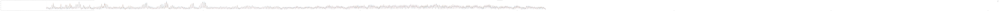

[0.02907449 0.03084116 0.02897193 ... 0.03830525 0.03270459 0.03143961]
Predictions(scale=array([1363.9298, 1302.7225, 1267.3131, ..., 1809.4912, 1755.6423,
       1548.4707], dtype=float32), s=array([0.02907449, 0.03084116, 0.02897193, ..., 0.03830525, 0.03270459,
       0.03143961], dtype=float32))


In [56]:
# lognorm
from sklearn.model_selection import cross_val_score
from sklearn.metrics import r2_score, median_absolute_error, mean_absolute_error
from sklearn.metrics import median_absolute_error, mean_squared_error, mean_squared_log_error
from xgboost import XGBRegressor 
from xgboost_distribution import XGBDistribution

def plotModelResults(model, X_train=X_train, X_test=X_test, plot_intervals=False, plot_anomalies=False, scale=19.6):
    """
        Plots modelled vs fact values, prediction intervals and anomalies
    
    """
    
    prediction = model.predict(X_test)
    
    plt.figure(figsize=(600, 7))
    plt.plot(prediction, "g", label="prediction", linewidth=2.0)
#     plt.plot(y_test.values, label="actual", linewidth=2.0)

    print(y_test)
    print(prediction)
    plt.show()

xgb = XGBDistribution(distribution="log-normal")
xgb.fit(X_train_scaled, y_train)
testpred = xgb.predict(X_test_scaled)

mean, std = testpred.scale, testpred.s


plt.figure(figsize=(600, 7))
plt.plot(mean, "g", label="prediction", linewidth=2.0)
plt.plot(y_test.values, label="actual", linewidth=2.0)
plt.plot(mean+np.exp(std), "r--",label="upper", alpha=0.5,linewidth=2.0)
plt.plot(mean-np.exp(std),"r--", label="lower", alpha=0.5,linewidth=2.0)
error = mean_absolute_percentage_error(mean, y_test)
# print(y_test)
# print(prediction)
print(error)
plt.title("Mean absolute percentage error {0:.2f}%".format(error))
rmse = np.sqrt(mean_squared_error(mean, y_test))
print("RMSE: %f" % (rmse))
plt.legend(loc="best")
plt.tight_layout()
plt.grid(True);
plt.show()

print(std)


print(testpred)

C:\Users\bcjsp\anaconda3\envs\CV\lib\site-packages\ipykernel_launcher.py:10: UserWarning: FixedFormatter should only be used together with FixedLocator
  # Remove the CWD from sys.path while we load stuff.


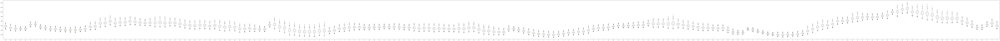

In [57]:
fig = plt.figure(figsize =(180, 7))
ax = fig.add_axes([1, 1, 1, 1])
data = []
for i in range(200): #change to any numbers
    np.random.seed(1)

#generate log-normal distributed random variable with 1000 values
    lognorm_values = lognorm.rvs(s=testpred.s[i], scale=testpred.scale[i], size=1000)
    data.append(lognorm_values)
ax.set_xticklabels(X_test.hour[0:200])    
ax.boxplot(x=data)
# plt.plot(y_test_reset[0:200])
# ax.plot(y_test_reset[0:200],linewidth = 2.0)
# ax.plot(y_test[0:200])

plt.show()    

<BarContainer object of 23 artists>

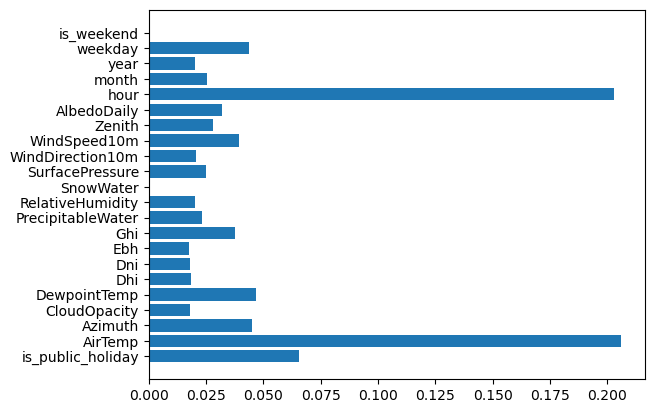

In [58]:
plt.barh(X_train.columns, xgb.feature_importances_)

# TAS Data

In [59]:
df_TAS=TAS_data
TAS_data['date'] = pd.to_datetime(df_TAS['SETTLEMENTDATE'], format="%Y-%m-%d %H:%M:%S.%f")
Public_Holidays_data['date'] = pd.to_datetime(Public_Holidays_data['Date'], format="%Y-%m-%d %H:%M:%S.%f")
Public_Holidays_data

df_TAS['is_public_holiday'] = 0
for j in range(len(df_TAS)):
    for i in range(len(Public_Holidays_data)):
        if Public_Holidays_data['Official_TAS'][i] == True or Public_Holidays_data['AFMA_TAS'][i] == True:
            if Public_Holidays_data['Timedate'][i] == TAS_data['date'][j].date(): 
                print(TAS_data['date'][j].date())
                df_TAS['is_public_holiday'][j] = 1 

C:\Users\bcjsp\anaconda3\envs\CV\lib\site-packages\ipykernel_launcher.py:10: FutureWarning: Comparison of Timestamp with datetime.date is deprecated in order to match the standard library behavior.  In a future version these will be considered non-comparable.Use 'ts == pd.Timestamp(date)' or 'ts.date() == date' instead.
  # Remove the CWD from sys.path while we load stuff.


2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02


C:\Users\bcjsp\anaconda3\envs\CV\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if sys.path[0] == "":


2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-02-13
2017-02-13
2017-02-13
2017-02-13
2017-02-13
2017-02-13
2017-02-13
2017-02-13
2017-02-13
2017-02-13

2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-02
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25
2018-04-25

2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-25
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01
2020-01-01

2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-04-25
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-06-14
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27
2021-12-27

In [60]:
df_TAS.to_csv('TAS_df.csv')

In [61]:
data = pd.DataFrame(TAS_data.added_PV_TOTALDEMAND.copy())
data.columns = ["y"]
data["hour"] = df_TAS.date.dt.hour
data["month"] = df_TAS.date.dt.month
data["year"] = df_TAS.date.dt.year
data["weekday"] = df_TAS.date.dt.weekday
data['is_weekend'] = data.weekday.isin([5,6])*1
data["is_public_holiday"] = df_TAS.is_public_holiday
data

,y,hour,month,year,weekday,is_weekend,is_public_holiday
0,863.08000,0,1,2017,6,1,0
1,872.00000,1,1,2017,6,1,0
2,852.53000,1,1,2017,6,1,0
3,832.05000,2,1,2017,6,1,0
4,815.47000,2,1,2017,6,1,0
...,...,...,...,...,...,...,...
96331,1332.19000,22,6,2022,3,0,0
96332,1264.64667,22,6,2022,3,0,0
96333,1212.10833,23,6,2022,3,0,0
96334,1168.08167,23,6,2022,3,0,0


In [62]:
xlsx_file = "-42.882605_147.32572_Solcast_PT30M.csv"   #TAS
weather_data = pd.read_csv(xlsx_file)
weather_data['PeriodStart'][0]
weather_data['date'] = pd.to_datetime(weather_data['PeriodEnd'], format="%Y-%m-%dT%H:%M:%SZ")
weather_data
from datetime import timedelta
weather_data['date'] = weather_data['date'] + timedelta(hours=10)
weather_data
new_weather = weather_data.loc[weather_data['date']>='2017-01-01 01:00:00']
new_weather = new_weather.loc[new_weather['date']<='2022-07-01 00:00:00']
new = pd.concat([new_weather,df],axis=0)
new_merge = df.merge(new_weather,on=['date'])
# new_merge = new_merge.rename(columns={'TOTALDEMAND':'y'})
new_merge = new_merge.reset_index()
df_col = pd.concat([new_merge,data], axis=1)
train_data = df_col.drop(columns=['level_0','index','SETTLEMENTDATE','REGIONID','TOTALDEMAND','added_PV_TOTALDEMAND','date','PeriodEnd','PeriodStart','Period'])
train_data

,is_public_holiday,AirTemp,Azimuth,CloudOpacity,DewpointTemp,Dhi,Dni,Ebh,Ghi,PrecipitableWater,...,WindSpeed10m,Zenith,AlbedoDaily,y,hour,month,year,weekday,is_weekend,is_public_holiday
0,0.0,13.8,-172.0,0.0,11.9,0.0,0.0,0.0,0.0,20.5,...,1.5,114.0,0.10,863.08000,0,1,2017,6,1,0
1,0.0,13.7,-165.0,0.0,11.9,0.0,0.0,0.0,0.0,20.6,...,1.5,112.0,0.11,872.00000,1,1,2017,6,1,0
2,0.0,13.6,-157.0,0.0,11.9,0.0,0.0,0.0,0.0,20.7,...,1.5,111.0,0.11,852.53000,1,1,2017,6,1,0
3,0.0,13.5,-151.0,0.0,12.0,0.0,0.0,0.0,0.0,20.8,...,1.5,108.0,0.11,832.05000,2,1,2017,6,1,0
4,0.0,13.4,-144.0,0.0,12.0,0.0,0.0,0.0,0.0,20.9,...,1.5,105.0,0.11,815.47000,2,1,2017,6,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96331,0.0,3.9,119.0,17.7,0.6,0.0,0.0,0.0,0.0,8.7,...,1.8,149.0,0.13,1332.19000,22,6,2022,3,0,0
96332,0.0,3.7,130.0,14.5,0.5,0.0,0.0,0.0,0.0,8.8,...,1.9,153.0,0.13,1264.64667,22,6,2022,3,0,0
96333,0.0,3.5,144.0,7.0,0.5,0.0,0.0,0.0,0.0,8.8,...,2.0,157.0,0.13,1212.10833,23,6,2022,3,0,0
96334,0.0,3.4,161.0,1.6,0.4,0.0,0.0,0.0,0.0,8.9,...,2.0,159.0,0.13,1168.08167,23,6,2022,3,0,0


In [63]:
data = train_data
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

y = data.dropna().y
X = data.dropna().drop(['y'], axis=1)

X_train, X_test, y_train, y_test = timeseries_train_test_split(X, y, test_size=0.3)

X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

6.686625000185555
RMSE: 89.380370


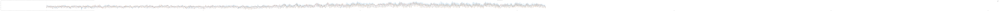

[0.03580694 0.03219898 0.03313601 ... 0.02730404 0.02768007 0.02611194]
Predictions(scale=array([1115.2377, 1059.5383, 1022.8102, ..., 1327.4558, 1262.886 ,
       1227.9459], dtype=float32), s=array([0.03580694, 0.03219898, 0.03313601, ..., 0.02730404, 0.02768007,
       0.02611194], dtype=float32))


In [64]:
# lognorm
from sklearn.model_selection import cross_val_score
from sklearn.metrics import r2_score, median_absolute_error, mean_absolute_error
from sklearn.metrics import median_absolute_error, mean_squared_error, mean_squared_log_error
from xgboost import XGBRegressor 
from xgboost_distribution import XGBDistribution

def plotModelResults(model, X_train=X_train, X_test=X_test, plot_intervals=False, plot_anomalies=False, scale=19.6):
    """
        Plots modelled vs fact values, prediction intervals and anomalies
    
    """
    
    prediction = model.predict(X_test)
    
    plt.figure(figsize=(600, 7))
    plt.plot(prediction, "g", label="prediction", linewidth=2.0)
#     plt.plot(y_test.values, label="actual", linewidth=2.0)

    print(y_test)
    print(prediction)
    plt.show()

xgb = XGBDistribution(distribution="log-normal")
xgb.fit(X_train_scaled, y_train)
testpred = xgb.predict(X_test_scaled)

mean, std = testpred.scale, testpred.s


plt.figure(figsize=(600, 7))
plt.plot(mean, "g", label="prediction", linewidth=2.0)
plt.plot(y_test.values, label="actual", linewidth=2.0)
plt.plot(mean+np.exp(std), "r--",label="upper", alpha=0.5,linewidth=2.0)
plt.plot(mean-np.exp(std),"r--", label="lower", alpha=0.5,linewidth=2.0)
error = mean_absolute_percentage_error(mean, y_test)
# print(y_test)
# print(prediction)
print(error)
plt.title("Mean absolute percentage error {0:.2f}%".format(error))
rmse = np.sqrt(mean_squared_error(mean, y_test))
print("RMSE: %f" % (rmse))
plt.legend(loc="best")
plt.tight_layout()
plt.grid(True);
plt.show()

print(std)


print(testpred)

C:\Users\bcjsp\anaconda3\envs\CV\lib\site-packages\ipykernel_launcher.py:10: UserWarning: FixedFormatter should only be used together with FixedLocator
  # Remove the CWD from sys.path while we load stuff.


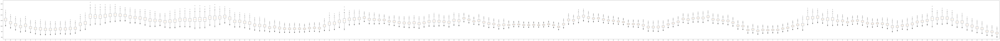

In [65]:
fig = plt.figure(figsize =(180, 7))
ax = fig.add_axes([1, 1, 1, 1])
data = []
for i in range(200): #change to any numbers
    np.random.seed(1)

#generate log-normal distributed random variable with 1000 values
    lognorm_values = lognorm.rvs(s=testpred.s[i], scale=testpred.scale[i], size=1000)
    data.append(lognorm_values)
ax.set_xticklabels(X_test.hour[0:200])    
ax.boxplot(x=data)
# plt.plot(y_test_reset[0:200])
# ax.plot(y_test_reset[0:200],linewidth = 2.0)
# ax.plot(y_test[0:200])

plt.show()    

<BarContainer object of 23 artists>

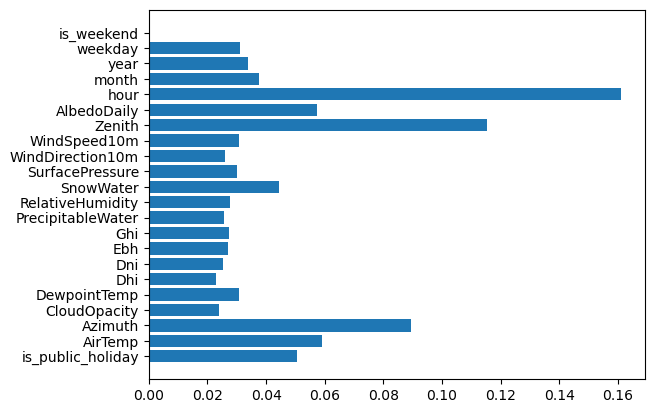

In [66]:
plt.barh(X_train.columns, xgb.feature_importances_)

# QLD Data

In [67]:
df_QLD=QLD_data
QLD_data['date'] = pd.to_datetime(df_QLD['SETTLEMENTDATE'], format="%Y-%m-%d %H:%M:%S.%f")
Public_Holidays_data['date'] = pd.to_datetime(Public_Holidays_data['Date'], format="%Y-%m-%d %H:%M:%S.%f")
Public_Holidays_data

df_QLD['is_public_holiday'] = 0
for j in range(len(df_QLD)):
    for i in range(len(Public_Holidays_data)):
        if Public_Holidays_data['Official_QLD'][i] == True or Public_Holidays_data['AFMA_QLD'][i] == True:
            if Public_Holidays_data['Timedate'][i] == QLD_data['date'][j].date(): 
                print(QLD_data['date'][j].date())
                df_QLD['is_public_holiday'][j] = 1

C:\Users\bcjsp\anaconda3\envs\CV\lib\site-packages\ipykernel_launcher.py:10: FutureWarning: Comparison of Timestamp with datetime.date is deprecated in order to match the standard library behavior.  In a future version these will be considered non-comparable.Use 'ts == pd.Timestamp(date)' or 'ts.date() == date' instead.
  # Remove the CWD from sys.path while we load stuff.


2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02


C:\Users\bcjsp\anaconda3\envs\CV\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if sys.path[0] == "":


2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-02
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-01-26
2017-04-14
2017-04-14
2017-04-14
2017-04-14
2017-04-14
2017-04-14
2017-04-14
2017-04-14
2017-04-14
2017-04-14
2017-04-14
2017-04-14
2017-04-14
2017-04-14

2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-25
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26

2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-04-25
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04

2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2021-12-28
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-03
2022-01-26
2022-01-26
2022-01-26
2022-01-26
2022-01-26
2022-01-26
2022-01-26
2022-01-26
2022-01-26
2022-01-26
2022-01-26
2022-01-26
2022-01-26
2022-01-26
2022-01-26
2022-01-26
2022-01-26
2022-01-26
2022-01-26
2022-01-26
2022-01-26
2022-01-26
2022-01-26

In [68]:
df_QLD.to_csv('QLD_df.csv')

In [71]:
data = pd.DataFrame(QLD_data.added_PV_TOTALDEMAND.copy())
data.columns = ["y"]
data["hour"] = df_QLD.date.dt.hour
data["month"] = df_QLD.date.dt.month
data["year"] = df_QLD.date.dt.year
data["weekday"] = df_QLD.date.dt.weekday
data['is_weekend'] = data.weekday.isin([5,6])*1
data["is_public_holiday"] = df_QLD.is_public_holiday
data

,y,hour,month,year,weekday,is_weekend,is_public_holiday
0,6462.14000,0,1,2017,6,1,0
1,6352.82000,1,1,2017,6,1,0
2,6261.02000,1,1,2017,6,1,0
3,6169.66000,2,1,2017,6,1,0
4,6149.87000,2,1,2017,6,1,0
...,...,...,...,...,...,...,...
96331,6409.50333,22,6,2022,3,0,0
96332,6192.50667,22,6,2022,3,0,0
96333,6021.77000,23,6,2022,3,0,0
96334,5892.94167,23,6,2022,3,0,0


In [72]:
xlsx_file = "-27.470453_153.026034_Solcast_PT30M.csv"   #QLD
weather_data = pd.read_csv(xlsx_file)
weather_data['PeriodStart'][0]
weather_data['date'] = pd.to_datetime(weather_data['PeriodEnd'], format="%Y-%m-%dT%H:%M:%SZ")
weather_data
from datetime import timedelta
weather_data['date'] = weather_data['date'] + timedelta(hours=10)
weather_data
new_weather = weather_data.loc[weather_data['date']>='2017-01-01 01:00:00']
new_weather = new_weather.loc[new_weather['date']<='2022-07-01 00:00:00']
new = pd.concat([new_weather,df],axis=0)
new_merge = df.merge(new_weather,on=['date'])
# new_merge = new_merge.rename(columns={'TOTALDEMAND':'y'})
new_merge = new_merge.reset_index()
df_col = pd.concat([new_merge,data], axis=1)
train_data = df_col.drop(columns=['level_0','index','SETTLEMENTDATE','REGIONID','TOTALDEMAND','added_PV_TOTALDEMAND','date','PeriodEnd','PeriodStart','Period'])
train_data

,is_public_holiday,AirTemp,Azimuth,CloudOpacity,DewpointTemp,Dhi,Dni,Ebh,Ghi,PrecipitableWater,...,WindSpeed10m,Zenith,AlbedoDaily,y,hour,month,year,weekday,is_weekend,is_public_holiday
0,0.0,24.5,-164.0,0.0,20.2,0.0,0.0,0.0,0.0,38.7,...,3.0,128.0,0.11,6462.14000,0,1,2017,6,1,0
1,0.0,24.2,-156.0,0.0,20.1,0.0,0.0,0.0,0.0,38.7,...,3.0,125.0,0.11,6352.82000,1,1,2017,6,1,0
2,0.0,24.1,-149.0,0.0,20.1,0.0,0.0,0.0,0.0,38.7,...,2.9,122.0,0.11,6261.02000,1,1,2017,6,1,0
3,0.0,23.9,-142.0,0.0,20.2,0.0,0.0,0.0,0.0,38.7,...,2.7,119.0,0.11,6169.66000,2,1,2017,6,1,0
4,0.0,23.8,-136.0,0.0,20.2,0.0,0.0,0.0,0.0,38.8,...,2.6,114.0,0.11,6149.87000,2,1,2017,6,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96331,0.0,16.7,96.0,68.5,15.7,0.0,0.0,0.0,0.0,36.2,...,1.4,158.0,0.11,6409.50333,22,6,2022,3,0,0
96332,0.0,16.6,102.0,67.5,15.7,0.0,0.0,0.0,0.0,36.3,...,1.4,165.0,0.11,6192.50667,22,6,2022,3,0,0
96333,0.0,16.5,117.0,74.6,15.6,0.0,0.0,0.0,0.0,37.0,...,1.4,171.0,0.11,6021.77000,23,6,2022,3,0,0
96334,0.0,16.4,165.0,70.1,15.5,0.0,0.0,0.0,0.0,38.1,...,1.5,175.0,0.12,5892.94167,23,6,2022,3,0,0


In [73]:
data = train_data
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

y = data.dropna().y
X = data.dropna().drop(['y'], axis=1)

X_train, X_test, y_train, y_test = timeseries_train_test_split(X, y, test_size=0.3)

X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

4.197175481585388
RMSE: 350.068577


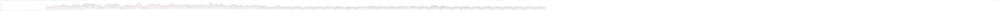

[0.00871287 0.01542689 0.01233998 ... 0.01061775 0.0073397  0.00672132]
Predictions(scale=array([7161.272 , 6729.677 , 6500.643 , ..., 6271.6357, 6061.543 ,
       5999.7637], dtype=float32), s=array([0.00871287, 0.01542689, 0.01233998, ..., 0.01061775, 0.0073397 ,
       0.00672132], dtype=float32))


In [74]:
# lognorm
from sklearn.model_selection import cross_val_score
from sklearn.metrics import r2_score, median_absolute_error, mean_absolute_error
from sklearn.metrics import median_absolute_error, mean_squared_error, mean_squared_log_error
from xgboost import XGBRegressor 
from xgboost_distribution import XGBDistribution

def plotModelResults(model, X_train=X_train, X_test=X_test, plot_intervals=False, plot_anomalies=False, scale=19.6):
    """
        Plots modelled vs fact values, prediction intervals and anomalies
    
    """
    
    prediction = model.predict(X_test)
    
    plt.figure(figsize=(600, 7))
    plt.plot(prediction, "g", label="prediction", linewidth=2.0)
#     plt.plot(y_test.values, label="actual", linewidth=2.0)

    print(y_test)
    print(prediction)
    plt.show()

xgb = XGBDistribution(distribution="log-normal")
xgb.fit(X_train_scaled, y_train)
testpred = xgb.predict(X_test_scaled)

mean, std = testpred.scale, testpred.s


plt.figure(figsize=(600, 7))
plt.plot(mean, "g", label="prediction", linewidth=2.0)
plt.plot(y_test.values, label="actual", linewidth=2.0)
plt.plot(mean+np.exp(std), "r--",label="upper", alpha=0.5,linewidth=2.0)
plt.plot(mean-np.exp(std),"r--", label="lower", alpha=0.5,linewidth=2.0)
error = mean_absolute_percentage_error(mean, y_test)
# print(y_test)
# print(prediction)
print(error)
plt.title("Mean absolute percentage error {0:.2f}%".format(error))
rmse = np.sqrt(mean_squared_error(mean, y_test))
print("RMSE: %f" % (rmse))
plt.legend(loc="best")
plt.tight_layout()
plt.grid(True);
plt.show()

print(std)


print(testpred)

C:\Users\bcjsp\anaconda3\envs\CV\lib\site-packages\ipykernel_launcher.py:10: UserWarning: FixedFormatter should only be used together with FixedLocator
  # Remove the CWD from sys.path while we load stuff.


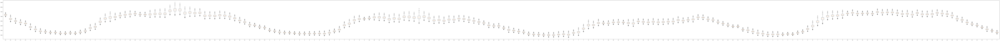

In [75]:
fig = plt.figure(figsize =(180, 7))
ax = fig.add_axes([1, 1, 1, 1])
data = []
for i in range(200): #change to any numbers
    np.random.seed(1)

#generate log-normal distributed random variable with 1000 values
    lognorm_values = lognorm.rvs(s=testpred.s[i], scale=testpred.scale[i], size=1000)
    data.append(lognorm_values)
ax.set_xticklabels(X_test.hour[0:200])    
ax.boxplot(x=data)
# plt.plot(y_test_reset[0:200])
# ax.plot(y_test_reset[0:200],linewidth = 2.0)
# ax.plot(y_test[0:200])

plt.show()    

<BarContainer object of 23 artists>

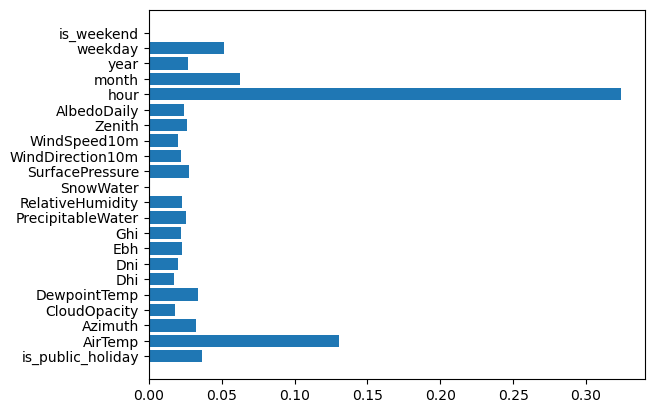

In [76]:
plt.barh(X_train.columns, xgb.feature_importances_)